In [78]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier,DecisionTreeRegressor, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,precision_score,recall_score,roc_auc_score
from sklearn.metrics import f1_score,roc_curve,confusion_matrix,classification_report
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [2]:
pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [3]:
df = pd.read_csv('Sales_Data.csv')

In [4]:
df.shape

(4923, 18)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4923 entries, 0 to 4922
Data columns (total 18 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   SKP_CODE        4923 non-null   int64  
 1   POS_NAME        4923 non-null   object 
 2   POS_TYPE        4923 non-null   object 
 3   POS_AREA        4923 non-null   object 
 4   STATUS          4923 non-null   object 
 5   DSM_EMP_ID      4923 non-null   int64  
 6   ASM_ID          3516 non-null   float64
 7   ZSM_EMP_ID_NEW  4923 non-null   int64  
 8   SIGNED_VOLUME   4923 non-null   int64  
 9   MTD_SIGNED      4923 non-null   int64  
 10  SA_AT_FP        4923 non-null   object 
 11  LOW_PRO_AP      4923 non-null   object 
 12  FP_WO_SALES     4923 non-null   object 
 13  AP_WO_SA        4923 non-null   object 
 14  FP_WO_RA        4923 non-null   object 
 15  PPC             4923 non-null   object 
 16  POS TYPE        4923 non-null   object 
 17  FINAL CHECK     4923 non-null   o

In [6]:
df.isnull().sum()

SKP_CODE             0
POS_NAME             0
POS_TYPE             0
POS_AREA             0
STATUS               0
DSM_EMP_ID           0
ASM_ID            1407
ZSM_EMP_ID_NEW       0
SIGNED_VOLUME        0
MTD_SIGNED           0
SA_AT_FP             0
LOW_PRO_AP           0
FP_WO_SALES          0
AP_WO_SA             0
FP_WO_RA             0
PPC                  0
POS TYPE             0
FINAL CHECK          0
dtype: int64

In [7]:
df.dtypes[df.dtypes == 'object']

POS_NAME       object
POS_TYPE       object
POS_AREA       object
STATUS         object
SA_AT_FP       object
LOW_PRO_AP     object
FP_WO_SALES    object
AP_WO_SA       object
FP_WO_RA       object
PPC            object
POS TYPE       object
FINAL CHECK    object
dtype: object

In [8]:
df['POS_NAME'].unique()

array(['VARDHMAN COMMUNICATION (ADDITIONAL)',
       'DHARTI COMPUTER ART AND MOBILE HOUSE', 'JAY MOBILE', ...,
       'SIMRAN', 'YASH COMMUNICATION', 'KAILASH RADIO CENTER (FP)'],
      dtype=object)

In [9]:
df['POS_TYPE'].unique()

array(['Satellite', 'Aldi', 'Non-Aldi', 'APHUB'], dtype=object)

In [10]:
df['POS_AREA'].unique()

array(['AHMEDABAD', 'RAJKOT', 'SURAT', 'NAGPUR', 'NASHIK', 'AURANGABAD',
       'VADODARA'], dtype=object)

In [11]:
df['STATUS'].unique()

array(['Active'], dtype=object)

In [12]:
df['SA_AT_FP'].unique()

array(['-', 'SA AT FP'], dtype=object)

In [13]:
df['LOW_PRO_AP'].unique()

array(['-', 'LOW Pro.AP'], dtype=object)

In [14]:
df['FP_WO_SALES'].unique()

array(['-', 'FP WO Sales'], dtype=object)

In [15]:
df['AP_WO_SA'].unique()

array(['-', 'AP WO SA'], dtype=object)

In [16]:
df['FP_WO_RA'].unique()

array(['-', 'FP WO RA'], dtype=object)

In [17]:
df['PPC'].unique()

array(['-', 'PPC'], dtype=object)

In [18]:
df['POS_TYPE'].unique()

array(['Satellite', 'Aldi', 'Non-Aldi', 'APHUB'], dtype=object)

In [19]:
df['FINAL CHECK'].unique()

array(['GOOD', 'FP WO Sales', 'LOW Pro.AP', 'PPC', 'FP WO RA', 'SA AT FP',
       'AP WO SA'], dtype=object)

In [20]:
df.head(10)

,SKP_CODE,POS_NAME,POS_TYPE,POS_AREA,STATUS,DSM_EMP_ID,ASM_ID,ZSM_EMP_ID_NEW,SIGNED_VOLUME,MTD_SIGNED,SA_AT_FP,LOW_PRO_AP,FP_WO_SALES,AP_WO_SA,FP_WO_RA,PPC,POS TYPE,FINAL CHECK
0,25821195,VARDHMAN COMMUNICATION (ADDITIONAL),Satellite,AHMEDABAD,Active,26611,76421.0,16919,17000,1,-,-,-,-,-,-,FP,GOOD
1,217194,DHARTI COMPUTER ART AND MOBILE HOUSE,Satellite,RAJKOT,Active,29810,NaN,16919,84464,5,-,-,-,-,-,-,FP,GOOD
2,217199,JAY MOBILE,Aldi,SURAT,Active,22027,6080.0,16919,0,0,-,-,FP WO Sales,-,-,-,FP,FP WO Sales
3,29760028,MAHAVIR MOBILE SHOP,Aldi,RAJKOT,Active,29810,NaN,16919,22869,3,-,-,-,-,-,-,FP,GOOD
4,25527067,BHATIA COMMUNICATIONS AND RETAIL INDIA PRIVATE...,Non-Aldi,SURAT,Active,22027,6080.0,16919,113682,9,-,LOW Pro.AP,-,-,-,-,AP,LOW Pro.AP
5,1233509,DEV ENTERPRISES,Aldi,AHMEDABAD,Active,26611,76421.0,16919,0,0,-,-,-,-,-,-,FP,GOOD
6,129862,MANISH TELECOM,Aldi,SURAT,Active,22027,6080.0,16919,0,0,-,-,FP WO Sales,-,-,-,FP,FP WO Sales
7,458764,ROYAL TRADERS,Satellite,AHMEDABAD,Active,61937,76421.0,16919,56945,5,-,-,-,-,-,-,FP,GOOD
8,25821208,SMART HOUSE,Satellite,AHMEDABAD,Active,61937,76421.0,16919,37452,3,-,-,-,-,-,-,FP,GOOD
9,5235495,DWARKESH ENTERPRISE,Non-Aldi,RAJKOT,Active,29810,NaN,16919,162051,16,-,-,-,-,-,-,AP,GOOD


In [21]:
df.columns

Index(['SKP_CODE', 'POS_NAME', 'POS_TYPE', 'POS_AREA', 'STATUS', 'DSM_EMP_ID',
       'ASM_ID', 'ZSM_EMP_ID_NEW', 'SIGNED_VOLUME', 'MTD_SIGNED', 'SA_AT_FP',
       'LOW_PRO_AP', 'FP_WO_SALES', 'AP_WO_SA', 'FP_WO_RA', 'PPC', 'POS TYPE',
       'FINAL CHECK'],
      dtype='object')

In [22]:
list = ['SKP_CODE','POS_TYPE','POS_AREA','DSM_EMP_ID','ASM_ID','SIGNED_VOLUME','MTD_SIGNED','SA_AT_FP',
       'LOW_PRO_AP', 'FP_WO_SALES', 'AP_WO_SA', 'FP_WO_RA','FINAL CHECK']

In [23]:
df1 = df.copy()

In [24]:
df1.drop(['POS_NAME','STATUS','ZSM_EMP_ID_NEW'],axis = 1, inplace = True)

In [25]:
df1

,SKP_CODE,POS_TYPE,POS_AREA,DSM_EMP_ID,ASM_ID,SIGNED_VOLUME,MTD_SIGNED,SA_AT_FP,LOW_PRO_AP,FP_WO_SALES,AP_WO_SA,FP_WO_RA,PPC,POS TYPE,FINAL CHECK
0,25821195,Satellite,AHMEDABAD,26611,76421.0,17000,1,-,-,-,-,-,-,FP,GOOD
1,217194,Satellite,RAJKOT,29810,NaN,84464,5,-,-,-,-,-,-,FP,GOOD
2,217199,Aldi,SURAT,22027,6080.0,0,0,-,-,FP WO Sales,-,-,-,FP,FP WO Sales
3,29760028,Aldi,RAJKOT,29810,NaN,22869,3,-,-,-,-,-,-,FP,GOOD
4,25527067,Non-Aldi,SURAT,22027,6080.0,113682,9,-,LOW Pro.AP,-,-,-,-,AP,LOW Pro.AP
5,1233509,Aldi,AHMEDABAD,26611,76421.0,0,0,-,-,-,-,-,-,FP,GOOD
6,129862,Aldi,SURAT,22027,6080.0,0,0,-,-,FP WO Sales,-,-,-,FP,FP WO Sales
7,458764,Satellite,AHMEDABAD,61937,76421.0,56945,5,-,-,-,-,-,-,FP,GOOD
8,25821208,Satellite,AHMEDABAD,61937,76421.0,37452,3,-,-,-,-,-,-,FP,GOOD
9,5235495,Non-Aldi,RAJKOT,29810,NaN,162051,16,-,-,-,-,-,-,AP,GOOD


In [26]:
df1.isnull().sum()

SKP_CODE            0
POS_TYPE            0
POS_AREA            0
DSM_EMP_ID          0
ASM_ID           1407
SIGNED_VOLUME       0
MTD_SIGNED          0
SA_AT_FP            0
LOW_PRO_AP          0
FP_WO_SALES         0
AP_WO_SA            0
FP_WO_RA            0
PPC                 0
POS TYPE            0
FINAL CHECK         0
dtype: int64

In [27]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4923 entries, 0 to 4922
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   SKP_CODE       4923 non-null   int64  
 1   POS_TYPE       4923 non-null   object 
 2   POS_AREA       4923 non-null   object 
 3   DSM_EMP_ID     4923 non-null   int64  
 4   ASM_ID         3516 non-null   float64
 5   SIGNED_VOLUME  4923 non-null   int64  
 6   MTD_SIGNED     4923 non-null   int64  
 7   SA_AT_FP       4923 non-null   object 
 8   LOW_PRO_AP     4923 non-null   object 
 9   FP_WO_SALES    4923 non-null   object 
 10  AP_WO_SA       4923 non-null   object 
 11  FP_WO_RA       4923 non-null   object 
 12  PPC            4923 non-null   object 
 13  POS TYPE       4923 non-null   object 
 14  FINAL CHECK    4923 non-null   object 
dtypes: float64(1), int64(4), object(10)
memory usage: 577.0+ KB


In [28]:
df1['SA_AT_FP'].unique()

array(['-', 'SA AT FP'], dtype=object)

In [29]:
df1.replace({"-": 0},inplace = True)

In [30]:
df1

,SKP_CODE,POS_TYPE,POS_AREA,DSM_EMP_ID,ASM_ID,SIGNED_VOLUME,MTD_SIGNED,SA_AT_FP,LOW_PRO_AP,FP_WO_SALES,AP_WO_SA,FP_WO_RA,PPC,POS TYPE,FINAL CHECK
0,25821195,Satellite,AHMEDABAD,26611,76421.0,17000,1,0,0,0,0,0,0,FP,GOOD
1,217194,Satellite,RAJKOT,29810,NaN,84464,5,0,0,0,0,0,0,FP,GOOD
2,217199,Aldi,SURAT,22027,6080.0,0,0,0,0,FP WO Sales,0,0,0,FP,FP WO Sales
3,29760028,Aldi,RAJKOT,29810,NaN,22869,3,0,0,0,0,0,0,FP,GOOD
4,25527067,Non-Aldi,SURAT,22027,6080.0,113682,9,0,LOW Pro.AP,0,0,0,0,AP,LOW Pro.AP
5,1233509,Aldi,AHMEDABAD,26611,76421.0,0,0,0,0,0,0,0,0,FP,GOOD
6,129862,Aldi,SURAT,22027,6080.0,0,0,0,0,FP WO Sales,0,0,0,FP,FP WO Sales
7,458764,Satellite,AHMEDABAD,61937,76421.0,56945,5,0,0,0,0,0,0,FP,GOOD
8,25821208,Satellite,AHMEDABAD,61937,76421.0,37452,3,0,0,0,0,0,0,FP,GOOD
9,5235495,Non-Aldi,RAJKOT,29810,NaN,162051,16,0,0,0,0,0,0,AP,GOOD


In [31]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4923 entries, 0 to 4922
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   SKP_CODE       4923 non-null   int64  
 1   POS_TYPE       4923 non-null   object 
 2   POS_AREA       4923 non-null   object 
 3   DSM_EMP_ID     4923 non-null   int64  
 4   ASM_ID         3516 non-null   float64
 5   SIGNED_VOLUME  4923 non-null   int64  
 6   MTD_SIGNED     4923 non-null   int64  
 7   SA_AT_FP       4923 non-null   object 
 8   LOW_PRO_AP     4923 non-null   object 
 9   FP_WO_SALES    4923 non-null   object 
 10  AP_WO_SA       4923 non-null   object 
 11  FP_WO_RA       4923 non-null   object 
 12  PPC            4923 non-null   object 
 13  POS TYPE       4923 non-null   object 
 14  FINAL CHECK    4923 non-null   object 
dtypes: float64(1), int64(4), object(10)
memory usage: 577.0+ KB


In [32]:
df1['LOW_PRO_AP'].unique()

array([0, 'LOW Pro.AP'], dtype=object)

In [33]:
df1.isnull().sum()

SKP_CODE            0
POS_TYPE            0
POS_AREA            0
DSM_EMP_ID          0
ASM_ID           1407
SIGNED_VOLUME       0
MTD_SIGNED          0
SA_AT_FP            0
LOW_PRO_AP          0
FP_WO_SALES         0
AP_WO_SA            0
FP_WO_RA            0
PPC                 0
POS TYPE            0
FINAL CHECK         0
dtype: int64

In [34]:
df1.dtypes[df1.dtypes == 'object']

POS_TYPE       object
POS_AREA       object
SA_AT_FP       object
LOW_PRO_AP     object
FP_WO_SALES    object
AP_WO_SA       object
FP_WO_RA       object
PPC            object
POS TYPE       object
FINAL CHECK    object
dtype: object

In [35]:
df1['POS_TYPE'].unique()

array(['Satellite', 'Aldi', 'Non-Aldi', 'APHUB'], dtype=object)

In [36]:
label_encoder = preprocessing.LabelEncoder()
df1['POS_TYPE'] = label_encoder.fit_transform(df1['POS_TYPE'])
df1['POS_TYPE'].unique()

array([3, 1, 2, 0])

In [37]:
df1['POS_AREA'].unique()

array(['AHMEDABAD', 'RAJKOT', 'SURAT', 'NAGPUR', 'NASHIK', 'AURANGABAD',
       'VADODARA'], dtype=object)

In [38]:
df1['POS_AREA'] = label_encoder.fit_transform(df1['POS_AREA'])
df1['POS_AREA'].unique()

array([0, 4, 5, 2, 3, 1, 6])

In [39]:
df1['SA_AT_FP'].unique()

array([0, 'SA AT FP'], dtype=object)

In [40]:
df1['SA_AT_FP'].replace({'SA AT FP':5}, inplace = True)
df1['SA_AT_FP'].unique()

array([0, 5], dtype=int64)

In [41]:
df1['LOW_PRO_AP'].unique()

array([0, 'LOW Pro.AP'], dtype=object)

In [42]:
df1['LOW_PRO_AP'].replace({'LOW Pro.AP':3}, inplace = True)
df1['LOW_PRO_AP'].unique()

array([0, 3], dtype=int64)

In [43]:
df1['FP_WO_SALES'].unique()

array([0, 'FP WO Sales'], dtype=object)

In [44]:
df1['FP_WO_SALES'].replace({'FP WO Sales':6}, inplace = True)
df1['FP_WO_SALES'].unique()

array([0, 6], dtype=int64)

In [45]:
df1['AP_WO_SA'].unique()

array([0, 'AP WO SA'], dtype=object)

In [46]:
df1['AP_WO_SA'].replace({'AP WO SA':2}, inplace = True)
df1['AP_WO_SA'].unique()

array([0, 2], dtype=int64)

In [47]:
df1['FP_WO_RA'].unique()

array([0, 'FP WO RA'], dtype=object)

In [48]:
df1['FP_WO_RA'].replace({'FP WO RA':4}, inplace = True)
df1['FP_WO_RA'].unique()

array([0, 4], dtype=int64)

In [49]:
df1['POS TYPE'].unique()

array(['FP', 'AP'], dtype=object)

In [50]:
df1['POS TYPE'] = label_encoder.fit_transform(df1['POS TYPE'])
df1['POS TYPE'].unique()

array([1, 0])

In [51]:
df1['PPC'].unique()

array([0, 'PPC'], dtype=object)

In [52]:
df1['PPC'].replace({'PPC':7}, inplace = True)
df1['PPC'].unique()

array([0, 7], dtype=int64)

In [53]:
df1['FINAL CHECK'].unique()

array(['GOOD', 'FP WO Sales', 'LOW Pro.AP', 'PPC', 'FP WO RA', 'SA AT FP',
       'AP WO SA'], dtype=object)

In [54]:
df1['FINAL CHECK'].replace({'GOOD':1,'FP WO Sales':6,'LOW Pro.AP':3,'PPC':7,'FP WO RA':4 ,'SA AT FP':5 ,'AP WO SA':2 }, inplace = True)
df1['FINAL CHECK'].unique()

array([1, 6, 3, 7, 4, 5, 2], dtype=int64)

In [55]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4923 entries, 0 to 4922
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   SKP_CODE       4923 non-null   int64  
 1   POS_TYPE       4923 non-null   int32  
 2   POS_AREA       4923 non-null   int32  
 3   DSM_EMP_ID     4923 non-null   int64  
 4   ASM_ID         3516 non-null   float64
 5   SIGNED_VOLUME  4923 non-null   int64  
 6   MTD_SIGNED     4923 non-null   int64  
 7   SA_AT_FP       4923 non-null   int64  
 8   LOW_PRO_AP     4923 non-null   int64  
 9   FP_WO_SALES    4923 non-null   int64  
 10  AP_WO_SA       4923 non-null   int64  
 11  FP_WO_RA       4923 non-null   int64  
 12  PPC            4923 non-null   int64  
 13  POS TYPE       4923 non-null   int32  
 14  FINAL CHECK    4923 non-null   int64  
dtypes: float64(1), int32(3), int64(11)
memory usage: 519.3 KB


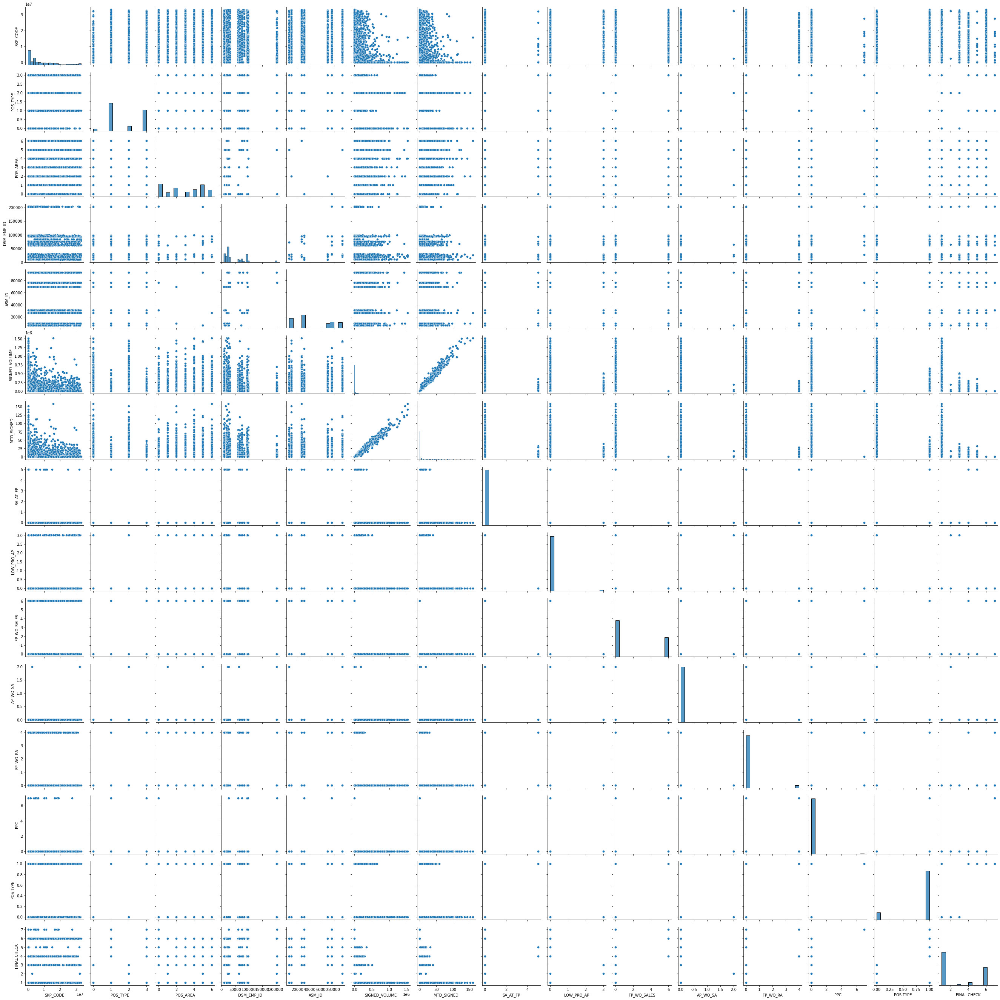

In [56]:
sns.pairplot(df1, kind ='scatter')

In [57]:
df1['ASM_ID'].value_counts()

30969.0    606
26594.0    581
6080.0     527
76421.0    525
93453.0    521
69461.0    403
9502.0     353
Name: ASM_ID, dtype: int64

In [58]:
df1['ASM_ID'].describe()

count     3516.000000
mean     44817.837031
std      31742.736291
min       6080.000000
25%       9502.000000
50%      30969.000000
75%      76421.000000
max      93453.000000
Name: ASM_ID, dtype: float64

In [59]:
df1['ASM_ID'].unique()

array([76421.,    nan,  6080.,  9502., 30969., 93453., 26594., 69461.])

In [60]:
df2 = df1.copy()

In [61]:
df1['ASM_ID'].replace({76421.:'ASM1',6080.:'ASM2',9502.:'ASM3',30969.:'ASM4',93453.:'ASM5' ,26594.:'ASM6' ,69461.:'ASM7' }, inplace =True)


In [62]:
df1

,SKP_CODE,POS_TYPE,POS_AREA,DSM_EMP_ID,ASM_ID,SIGNED_VOLUME,MTD_SIGNED,SA_AT_FP,LOW_PRO_AP,FP_WO_SALES,AP_WO_SA,FP_WO_RA,PPC,POS TYPE,FINAL CHECK
0,25821195,3,0,26611,ASM1,17000,1,0,0,0,0,0,0,1,1
1,217194,3,4,29810,NaN,84464,5,0,0,0,0,0,0,1,1
2,217199,1,5,22027,ASM2,0,0,0,0,6,0,0,0,1,6
3,29760028,1,4,29810,NaN,22869,3,0,0,0,0,0,0,1,1
4,25527067,2,5,22027,ASM2,113682,9,0,3,0,0,0,0,0,3
5,1233509,1,0,26611,ASM1,0,0,0,0,0,0,0,0,1,1
6,129862,1,5,22027,ASM2,0,0,0,0,6,0,0,0,1,6
7,458764,3,0,61937,ASM1,56945,5,0,0,0,0,0,0,1,1
8,25821208,3,0,61937,ASM1,37452,3,0,0,0,0,0,0,1,1
9,5235495,2,4,29810,NaN,162051,16,0,0,0,0,0,0,0,1


In [63]:
df1['ASM_ID'].replace({np.nan:"No_ASM" }, inplace =True)

In [64]:
dx = pd.get_dummies(df1,columns=['ASM_ID'])

In [65]:
dx

,SKP_CODE,POS_TYPE,POS_AREA,DSM_EMP_ID,SIGNED_VOLUME,MTD_SIGNED,SA_AT_FP,LOW_PRO_AP,FP_WO_SALES,AP_WO_SA,FP_WO_RA,PPC,POS TYPE,FINAL CHECK,ASM_ID_ASM1,ASM_ID_ASM2,ASM_ID_ASM3,ASM_ID_ASM4,ASM_ID_ASM5,ASM_ID_ASM6,ASM_ID_ASM7,ASM_ID_No_ASM
0,25821195,3,0,26611,17000,1,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0
1,217194,3,4,29810,84464,5,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1
2,217199,1,5,22027,0,0,0,0,6,0,0,0,1,6,0,1,0,0,0,0,0,0
3,29760028,1,4,29810,22869,3,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1
4,25527067,2,5,22027,113682,9,0,3,0,0,0,0,0,3,0,1,0,0,0,0,0,0
5,1233509,1,0,26611,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0
6,129862,1,5,22027,0,0,0,0,6,0,0,0,1,6,0,1,0,0,0,0,0,0
7,458764,3,0,61937,56945,5,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0
8,25821208,3,0,61937,37452,3,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0
9,5235495,2,4,29810,162051,16,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1


In [66]:
dx.drop(['ASM_ID_No_ASM'],axis =1 , inplace = True)

In [67]:
dx

,SKP_CODE,POS_TYPE,POS_AREA,DSM_EMP_ID,SIGNED_VOLUME,MTD_SIGNED,SA_AT_FP,LOW_PRO_AP,FP_WO_SALES,AP_WO_SA,FP_WO_RA,PPC,POS TYPE,FINAL CHECK,ASM_ID_ASM1,ASM_ID_ASM2,ASM_ID_ASM3,ASM_ID_ASM4,ASM_ID_ASM5,ASM_ID_ASM6,ASM_ID_ASM7
0,25821195,3,0,26611,17000,1,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0
1,217194,3,4,29810,84464,5,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0
2,217199,1,5,22027,0,0,0,0,6,0,0,0,1,6,0,1,0,0,0,0,0
3,29760028,1,4,29810,22869,3,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0
4,25527067,2,5,22027,113682,9,0,3,0,0,0,0,0,3,0,1,0,0,0,0,0
5,1233509,1,0,26611,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0
6,129862,1,5,22027,0,0,0,0,6,0,0,0,1,6,0,1,0,0,0,0,0
7,458764,3,0,61937,56945,5,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0
8,25821208,3,0,61937,37452,3,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0
9,5235495,2,4,29810,162051,16,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [68]:
dx['SKP_CODE'].unique()

array([25821195,   217194,   217199, ...,   121963,   114434,   124902],
      dtype=int64)

In [69]:
dx['DSM_EMP_ID'].unique()

array([ 26611,  29810,  22027,  61937,  11233,  20912,  93350,  12349,
        15446,  28734,  13155,  25244,  26938,  61770,  24572,  63676,
        94636,  25546,  98506,  64441,  12062,  72884,  11029,  95226,
        30556,  20064,  75294,  94894,  93349,  11256,  68467,  84146,
        28990,  78881,  20134,  96934,  28163,  11383,   9993,  68073,
        94676,  19179,   9367,  27374,  74999,  16178,  27589, 203464,
        21013,  93348,  22794,  25330,  22408,  27855,  94749,  24202,
        25856,  22561,  27382,  97384,  26654,  10221,  23182,  30668,
        24123,  67691,  20063,  95519,  10415,  18844, 202670],
      dtype=int64)

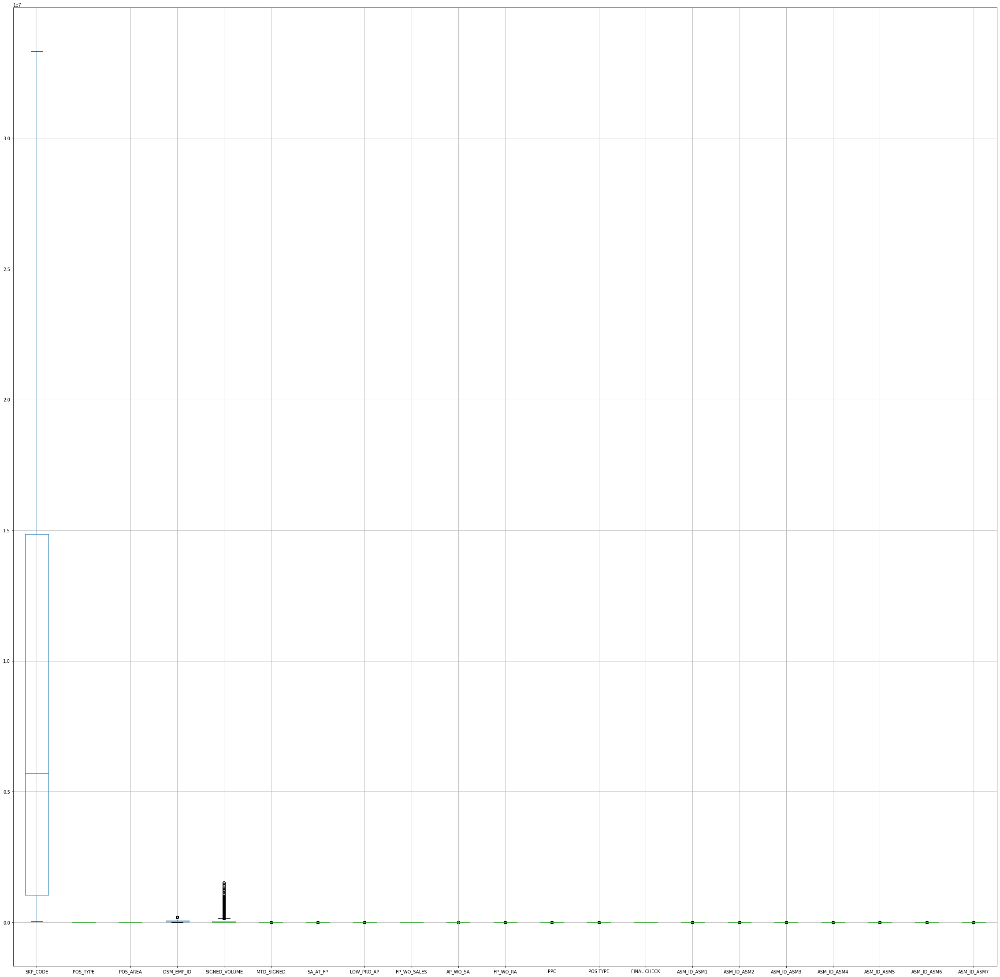

In [72]:
plt.figure(figsize=(40,40))
dx.boxplot()
plt.show()

In [86]:
x = dx.drop('FINAL CHECK',axis = 1)
y = dx['FINAL CHECK']

In [87]:
import imblearn
from imblearn.over_sampling import SMOTE

# over = SMOTE(sampling_strategy=0.1)
oversample = SMOTE()
x_smot, y_smot = oversample.fit_resample(x, y)

ImportError: cannot import name '_ClassNamePrefixFeaturesOutMixin' from 'sklearn.base' (C:\Users\VAIBHAV\anaconda3\lib\site-packages\sklearn\base.py)

In [77]:
x_train,x_test,y_train,y_test = train_test_split(x_smot,y_smot,test_size=0.2,random_state=42)

In [79]:
decision_tree = DecisionTreeRegressor()
decision_tree.fit(x_train,y_train)

DecisionTreeRegressor()

In [80]:
ypred = decision_tree.predict(x_test)

In [81]:
ypred

array([6., 6., 6., 1., 1., 1., 1., 1., 1., 1., 1., 6., 1., 6., 1., 6., 6.,
       1., 6., 1., 1., 1., 1., 1., 1., 6., 4., 6., 1., 6., 1., 5., 6., 1.,
       1., 4., 1., 1., 1., 1., 1., 1., 1., 1., 7., 6., 1., 1., 1., 1., 6.,
       1., 4., 1., 1., 1., 1., 6., 1., 1., 1., 1., 6., 5., 1., 6., 1., 1.,
       1., 1., 1., 6., 1., 1., 1., 6., 1., 1., 6., 1., 1., 1., 6., 1., 6.,
       1., 6., 1., 1., 1., 1., 1., 1., 3., 1., 1., 6., 4., 1., 6., 1., 1.,
       1., 1., 4., 1., 6., 6., 6., 1., 1., 1., 1., 6., 1., 6., 1., 6., 6.,
       3., 1., 1., 6., 1., 1., 1., 1., 1., 1., 1., 4., 1., 1., 6., 6., 4.,
       6., 1., 1., 6., 1., 6., 4., 1., 6., 1., 1., 6., 1., 1., 1., 3., 6.,
       1., 1., 1., 4., 6., 1., 1., 6., 1., 1., 6., 1., 6., 4., 1., 1., 6.,
       1., 1., 6., 6., 6., 6., 6., 6., 1., 1., 1., 1., 6., 1., 1., 1., 6.,
       6., 1., 1., 4., 1., 1., 1., 6., 1., 1., 1., 1., 3., 1., 6., 6., 1.,
       1., 6., 6., 1., 1., 1., 4., 6., 6., 1., 1., 1., 1., 6., 1., 1., 6.,
       6., 1., 1., 6., 6.

In [83]:
ytrain_predict = decision_tree.predict(x_train)

In [82]:
accuracy_score(y_test,ypred)

1.0

In [84]:
accuracy_score(y_train,ytrain_predict)

1.0